In [1]:
import pandas as pd


In [2]:
covid_data = pd.read_csv('data/covid_data.csv')
display(covid_data.head())

,date,province/state,country,confirmed,deaths,recovered
0,01/22/2020,Anhui,China,1.0,0.0,0.0
1,01/22/2020,Beijing,China,14.0,0.0,0.0
2,01/22/2020,Chongqing,China,6.0,0.0,0.0
3,01/22/2020,Fujian,China,1.0,0.0,0.0
4,01/22/2020,Gansu,China,0.0,0.0,0.0


In [3]:
vaccinations_data = pd.read_csv('data/country_vaccinations.csv')
vaccinations_data = vaccinations_data[
    ['country', 'date', 'total_vaccinations', 
     'people_vaccinated', 'people_vaccinated_per_hundred',
     'people_fully_vaccinated', 'people_fully_vaccinated_per_hundred',
     'daily_vaccinations', 'vaccines']
]

In [4]:
vaccinations_data.head()

,country,date,total_vaccinations,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,daily_vaccinations,vaccines
0,Afghanistan,2021-02-22,0.0,0.0,0.0,NaN,NaN,NaN,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi..."
1,Afghanistan,2021-02-23,NaN,NaN,NaN,NaN,NaN,1367.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi..."
2,Afghanistan,2021-02-24,NaN,NaN,NaN,NaN,NaN,1367.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi..."
3,Afghanistan,2021-02-25,NaN,NaN,NaN,NaN,NaN,1367.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi..."
4,Afghanistan,2021-02-26,NaN,NaN,NaN,NaN,NaN,1367.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi..."


In [5]:
covid_data =  covid_data.groupby(by=['date', 'country'], as_index=False)\
    [['confirmed', 'deaths', 'recovered']].sum()

In [6]:
covid_data['date'] = pd.to_datetime(covid_data['date'])

In [7]:
covid_data.head()

,date,country,confirmed,deaths,recovered
0,2021-01-01,Afghanistan,51526.0,2191.0,41727.0
1,2021-01-01,Albania,58316.0,1181.0,33634.0
2,2021-01-01,Algeria,99897.0,2762.0,67395.0
3,2021-01-01,Andorra,8117.0,84.0,7463.0
4,2021-01-01,Angola,17568.0,405.0,11146.0


In [8]:
covid_data['active'] = covid_data['confirmed']-covid_data['deaths']-covid_data['recovered']

In [9]:
covid_data = covid_data.sort_values(['country', 'date'])
covid_data['daily_confirmed'] = covid_data.groupby('country')['confirmed'].diff()
covid_data['daily_deaths'] = covid_data.groupby('country')['deaths'].diff()
covid_data['daily_recovered'] = covid_data.groupby('country')['recovered'].diff()

In [10]:
covid_data.head()

,date,country,confirmed,deaths,recovered,active,daily_confirmed,daily_deaths,daily_recovered
11337,2020-02-24,Afghanistan,1.0,0.0,0.0,1.0,NaN,NaN,NaN
11570,2020-02-25,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0
11807,2020-02-26,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0
12051,2020-02-27,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0
12299,2020-02-28,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0


In [11]:
vaccinations_data['date'] = pd.to_datetime(vaccinations_data['date'])

In [12]:
covid_data['date'].dt.date.min()

datetime.date(2020, 1, 22)

In [13]:
covid_data['date'].dt.date.max()

datetime.date(2021, 5, 29)

In [14]:
vaccinations_data['date'].dt.date.min()

datetime.date(2020, 12, 2)

In [15]:
vaccinations_data['date'].dt.date.max()

datetime.date(2021, 9, 6)

In [16]:
covid_df = covid_data.merge(vaccinations_data, on=['date', 'country'], how='left')

In [17]:
covid_df.to_csv('data/covid_df.csv', index=False)

In [18]:
covid_df

,date,country,confirmed,deaths,recovered,active,daily_confirmed,daily_deaths,daily_recovered,total_vaccinations,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,daily_vaccinations,vaccines
0,2020-02-24,Afghanistan,1.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-02-25,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-02-26,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-02-27,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-02-28,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86780,2020-03-12,occupied Palestinian territory,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86781,2020-03-14,occupied Palestinian territory,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86782,2020-03-15,occupied Palestinian territory,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86783,2020-03-16,occupied Palestinian territory,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [19]:
covid_df['death_rate'] = covid_df['deaths']/covid_df['confirmed']*100

In [20]:
covid_df['recover_rate'] = covid_df['recovered']/covid_df['confirmed']*100

In [21]:
mask = covid_df['country'] == 'Russia'
covid_df[mask]['recover_rate'].mean()

67.06273489477655

In [22]:
round(covid_df[covid_df['country'] == 'Russia']['recover_rate'].mean(), 2)

67.06

In [23]:
covid_df.head()

,date,country,confirmed,deaths,recovered,active,daily_confirmed,daily_deaths,daily_recovered,total_vaccinations,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,daily_vaccinations,vaccines,death_rate,recover_rate
0,2020-02-24,Afghanistan,1.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
1,2020-02-25,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
2,2020-02-26,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
3,2020-02-27,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0
4,2020-02-28,Afghanistan,1.0,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0


In [24]:
grouped_cases = covid_df.groupby('date')['daily_confirmed'].sum()

<AxesSubplot: xlabel='date'>

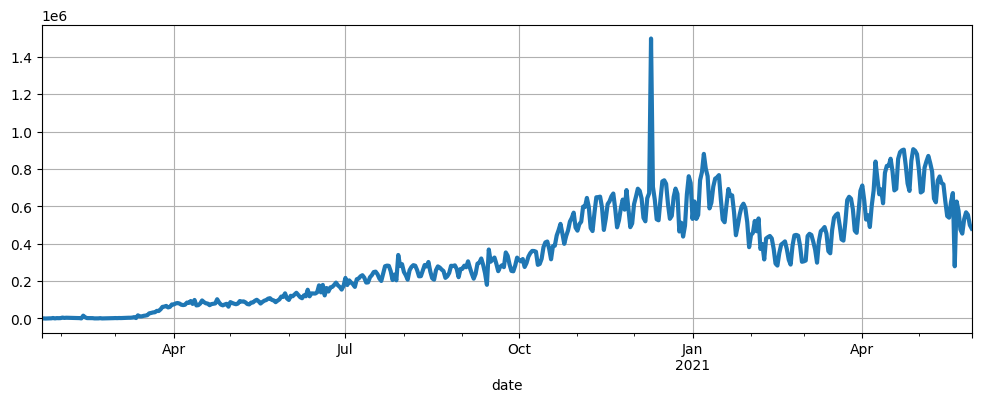

In [25]:
grouped_cases.plot(kind='line', figsize=(12, 4), grid=True, lw=3)

In [26]:
import matplotlib

In [27]:
grouped_country = covid_df.groupby('country')['confirmed'].last()

In [28]:
grouped_country = grouped_country.nlargest(10)

<AxesSubplot: xlabel='country'>

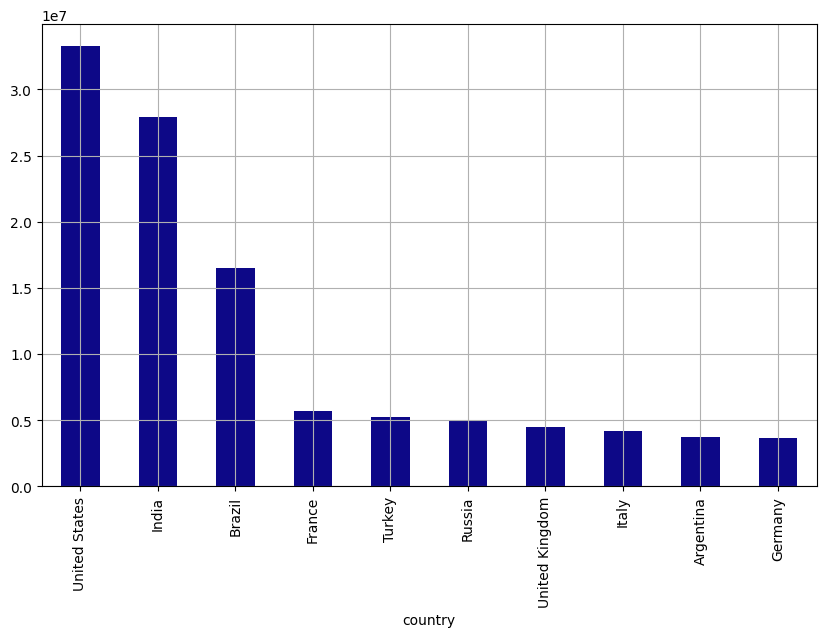

In [29]:
grouped_country.plot(kind='bar', figsize=(10, 6), grid=True, colormap='plasma')

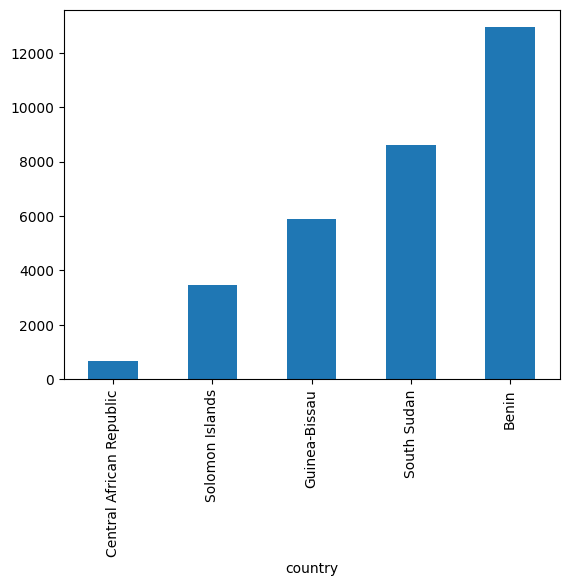

In [30]:
covid_df.groupby(['country'])['total_vaccinations'].last().nsmallest(5).plot(kind='bar');

In [31]:
import matplotlib.pyplot as plt

In [32]:
plt.style.use('default')

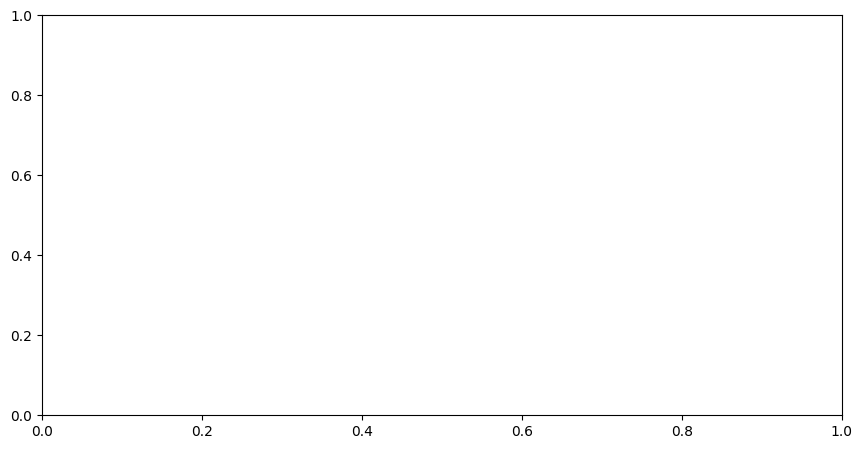

In [33]:
fig = plt.figure(figsize=(8, 4))
axes = fig.add_axes([0, 0, 1, 1])

In [34]:
us_data = covid_df[covid_df['country']=='United States']

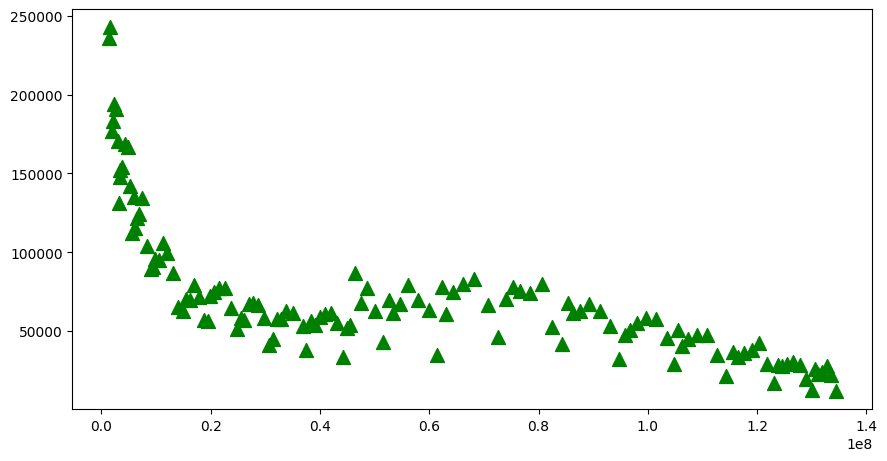

In [35]:
fig = plt.figure(figsize=(8, 4))
axes = fig.add_axes([0,0,1,1])
axes.scatter(x=us_data['people_fully_vaccinated'], y=us_data['daily_confirmed'], s=100, c='green', marker='^')

([<matplotlib.patches.Wedge at 0x209421839d0>,
 [Text(0.7665420934957, 0.9232622698341083, 'Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech'),
  Text(-0.5931469540063179, 0.9263782655875661, 'Oxford/AstraZeneca'),
  Text(-1.0669756518152362, 0.26751253883407417, 'Moderna, Oxford/AstraZeneca, Pfizer/BioNTech'),
  Text(-0.9691397141646498, -0.5203539318856552, 'Oxford/AstraZeneca, Sinopharm/Beijing'),
  Text(-0.42855913880528995, -1.013082950476647, 'Oxford/AstraZeneca, Pfizer/BioNTech'),
  Text(0.162764772670222, -1.0878913680959192, 'Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sputnik V'),
  Text(0.6404448584916131, -0.894332367317463, 'Moderna, Pfizer/BioNTech'),
  Text(0.9150658010408986, -0.610454404329577, 'Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing'),
  Text(1.03477305208093, -0.3731551027215323, 'Pfizer/BioNTech'),
  Text(1.092724197741022, -0.126308462389659, 'Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac, Sputnik V')],
 [Text(0.4471495545391

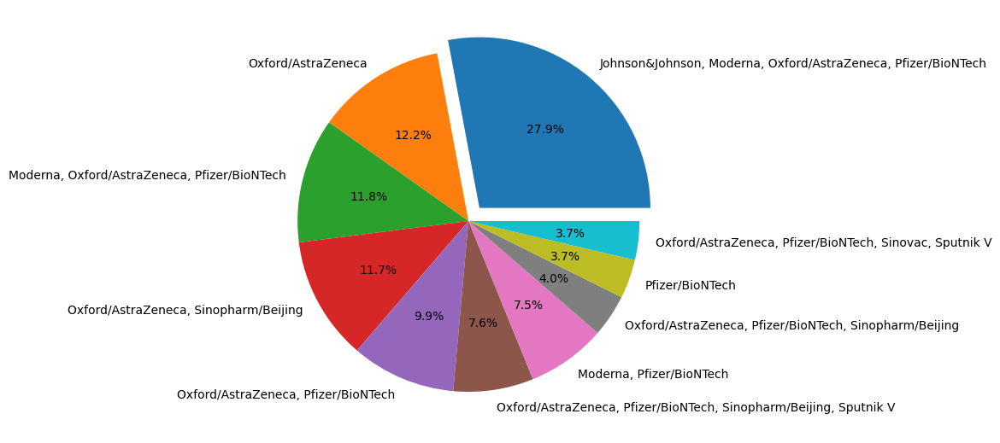

In [36]:
vaccine_combinations = covid_df['vaccines'].value_counts()[:10]
fig = plt.figure(figsize=(5,5))
axes = fig.add_axes([0,0,1,1])
axes.pie(vaccine_combinations, labels=vaccine_combinations.index, \
    autopct='%.1f%%', explode=[0.1,0,0,0,0,0,0,0,0,0])

In [37]:
china_data = covid_df[covid_df['country']=='China']
china_grouped = china_data.groupby('date')[['confirmed', 'deaths', 'recovered', 'active']].sum()

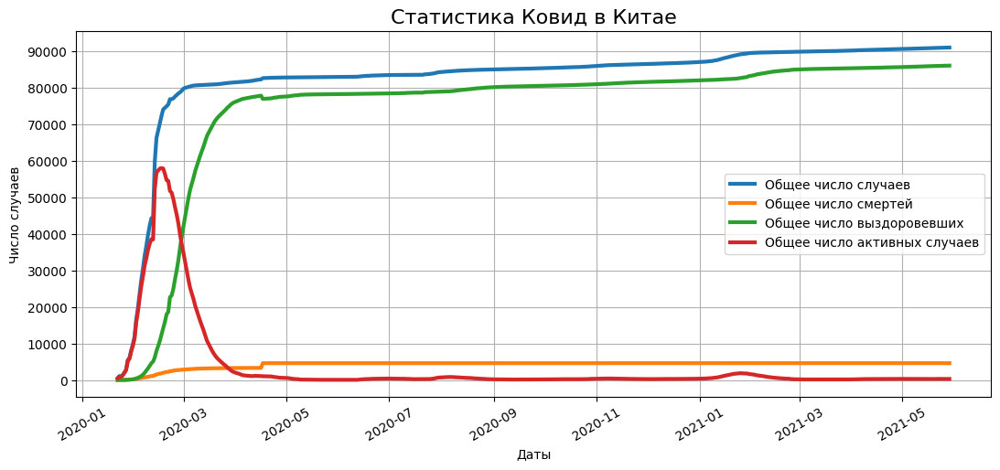

In [38]:


fig = plt.figure(figsize=(10, 4))
axes = fig.add_axes([0,0,1,1])
axes.plot(china_grouped['confirmed'], label='Общее число случаев', lw=3)
axes.plot(china_grouped['deaths'], label='Общее число смертей', lw=3)
axes.plot(china_grouped['recovered'], label='Общее число выздоровевших', lw=3)
axes.plot(china_grouped['active'], label='Общее число активных случаев', lw=3)

axes.set_title('Статистика Ковид в Китае', fontsize=16)
axes.set_xlabel('Даты')
axes.set_ylabel('Число случаев')
axes.set_yticks(range(0, 100000, 10000))
axes.xaxis.set_tick_params(rotation=30)
axes.grid()
axes.legend()

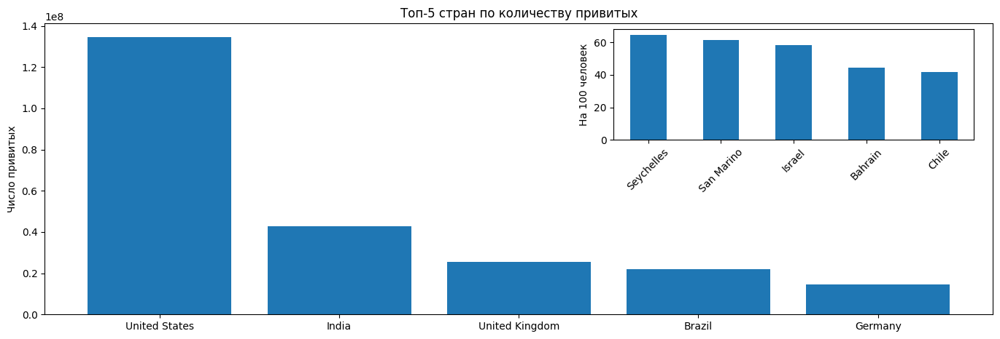

In [39]:
vacc_country = covid_df.groupby('country')['people_fully_vaccinated'].last().nlargest(5)
vacc_country_per_hundred = covid_df.groupby('country')['people_fully_vaccinated_per_hundred']\
    .last().nlargest(5)
fig = plt.figure(figsize=(13,4))
main_axes = fig.add_axes([0,0,1,1])
main_axes.bar(x=vacc_country.index, height=vacc_country)
main_axes.set_ylabel('Число привитых')
main_axes.set_title('Топ-5 стран по количеству привитых')

insert_axes = fig.add_axes([0.6,0.6,0.38,0.38])
insert_axes.bar(x=vacc_country_per_hundred.index, height=vacc_country_per_hundred, width=0.5)
insert_axes.set_ylabel('На 100 человек')
insert_axes.xaxis.set_tick_params(rotation=45)

ValueError: keyword ritation is not recognized; valid keywords are ['size', 'width', 'color', 'tickdir', 'pad', 'labelsize', 'labelcolor', 'zorder', 'gridOn', 'tick1On', 'tick2On', 'label1On', 'label2On', 'length', 'direction', 'left', 'bottom', 'right', 'top', 'labelleft', 'labelbottom', 'labelright', 'labeltop', 'labelrotation', 'grid_agg_filter', 'grid_alpha', 'grid_animated', 'grid_antialiased', 'grid_clip_box', 'grid_clip_on', 'grid_clip_path', 'grid_color', 'grid_dash_capstyle', 'grid_dash_joinstyle', 'grid_dashes', 'grid_data', 'grid_drawstyle', 'grid_figure', 'grid_fillstyle', 'grid_gapcolor', 'grid_gid', 'grid_in_layout', 'grid_label', 'grid_linestyle', 'grid_linewidth', 'grid_marker', 'grid_markeredgecolor', 'grid_markeredgewidth', 'grid_markerfacecolor', 'grid_markerfacecoloralt', 'grid_markersize', 'grid_markevery', 'grid_mouseover', 'grid_path_effects', 'grid_picker', 'grid_pickradius', 'grid_rasterized', 'grid_sketch_params', 'grid_snap', 'grid_solid_capstyle', 'grid_solid_joinstyle', 'grid_transform', 'grid_url', 'grid_visible', 'grid_xdata', 'grid_ydata', 'grid_zorder', 'grid_aa', 'grid_c', 'grid_ds', 'grid_ls', 'grid_lw', 'grid_mec', 'grid_mew', 'grid_mfc', 'grid_mfcalt', 'grid_ms']

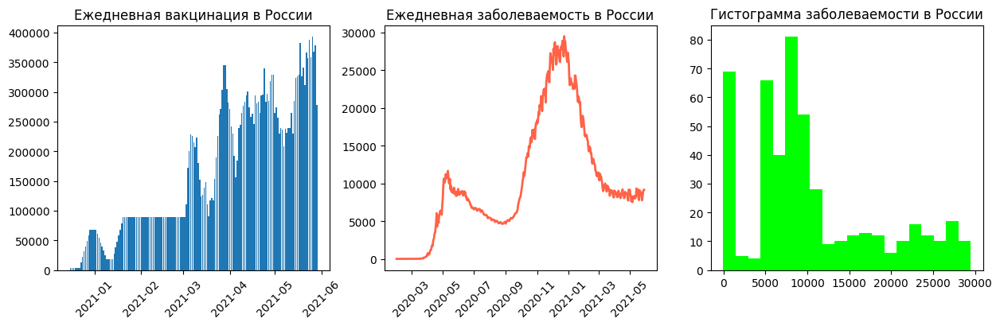

In [40]:
russia_data = covid_df[covid_df['country']=='Russia']
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15,4))
axes[0].bar(x=russia_data['date'], height=russia_data['daily_vaccinations'], \
    label='Число вакцинbрованных')
axes[0].set_title('Ежедневная вакцинация в России')
axes[0].xaxis.set_tick_params(rotation=45)

axes[1].plot(russia_data['date'], russia_data['daily_confirmed'], label='Число заболевших', \
    color='tomato', lw=2)
axes[1].set_title('Ежедневная заболеваемость в России')
axes[1].xaxis.set_tick_params(rotation=45)

axes[2].hist(x=russia_data['daily_confirmed'], label='Число заболевших', color='lime', bins=20)
axes[2].set_title('Гистограмма заболеваемости в России')
axes[2].xaxis.set_tick_params(ritation=30)

In [ ]:
import seaborn as sns
print(sns.__version__)

0.12.0


In [ ]:
countries = ['Russia','Australia','Germany','Canada','United Kingdom']
croped_covid_df = covid_df[covid_df['country'].isin(countries)]

populations = pd.DataFrame([['Russia', 145975300], ['Australia', 25726900], ['Canada', 37664517],\
    ['Germany', 83721496], ['United Kingdom', 67802690]], columns=['country','population'])




In [ ]:
croped_covid_df = croped_covid_df.merge(populations, on=['country'])
croped_covid_df['daily_confirmed_per_hundred'] = croped_covid_df['daily_confirmed']\
    /croped_covid_df['population']*100

In [ ]:
croped_covid_df.head()

,date,country,confirmed,deaths,recovered,active,daily_confirmed,daily_deaths,daily_recovered,total_vaccinations,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,daily_vaccinations,vaccines,death_rate,recover_rate,population,daily_confirmed_per_hundred
0,2020-01-23,Australia,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25726900,NaN
1,2020-01-25,Australia,4.0,0.0,0.0,4.0,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,25726900,0.000016
2,2020-01-26,Australia,4.0,0.0,0.0,4.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,25726900,0.000000
3,2020-01-27,Australia,5.0,0.0,0.0,5.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,25726900,0.000004
4,2020-01-28,Australia,5.0,0.0,0.0,5.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,25726900,0.000000


<AxesSubplot: xlabel='daily_confirmed_per_hundred', ylabel='country'>

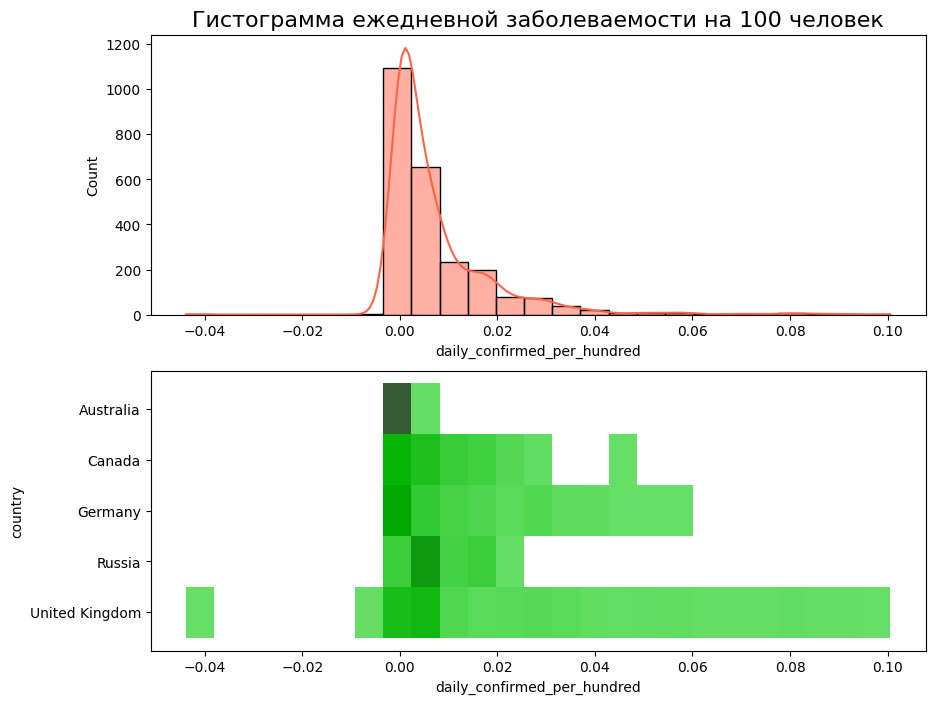

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10,8))
sns.histplot(data=croped_covid_df, x='daily_confirmed_per_hundred', bins=25, color='tomato', \
    ax=axes[0], kde=True)
axes[0].set_title('Гистограмма ежедневной заболеваемости на 100 человек', fontsize=16)
sns.histplot(data=croped_covid_df, x='daily_confirmed_per_hundred', y='country', bins=25, color='lime', ax=axes[1])

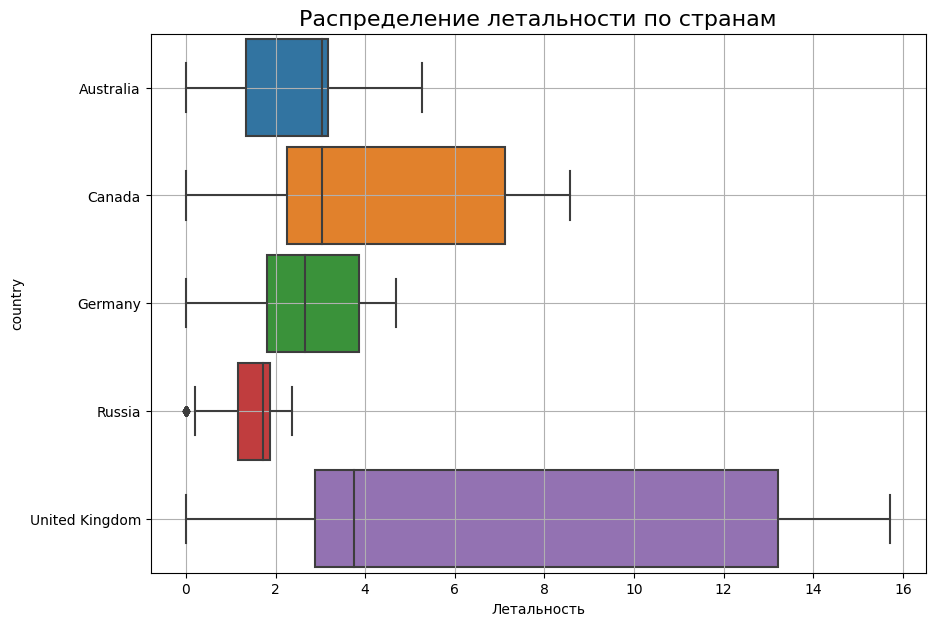

In [ ]:
fig = plt.figure(figsize=(10,7))
boxplot = sns.boxplot(data=croped_covid_df, x='death_rate', y='country', orient='h', width=0.9)
boxplot.set_title('Распределение летальности по странам', fontsize=16)
boxplot.set_xlabel('Летальность')
boxplot.grid()

Text(0.5, 1.0, 'Средний % болеющего населения по кварталам')

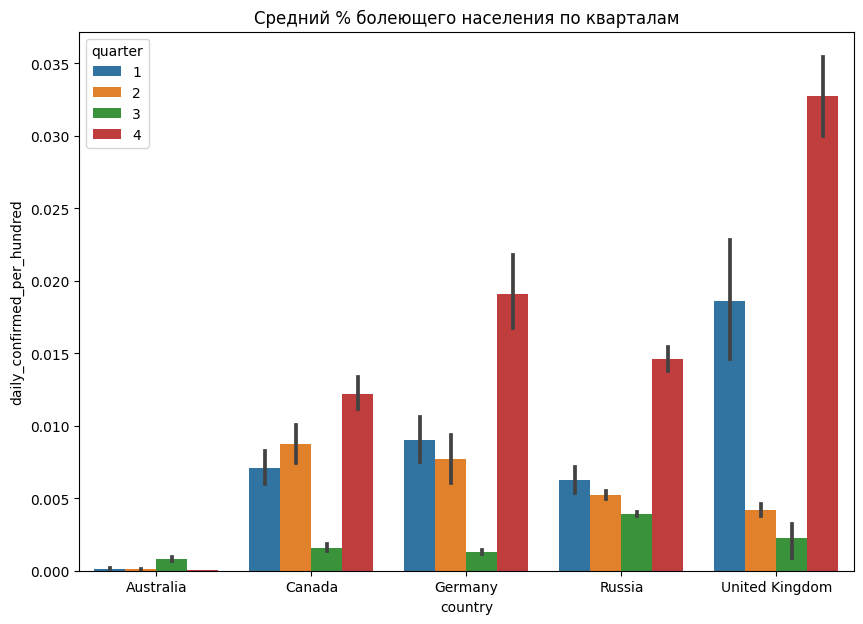

In [ ]:
fig = plt.figure(figsize=(10,7))
croped_covid_df['quarter'] = croped_covid_df['date'].dt.quarter
barplot = sns.barplot(data=croped_covid_df, x='country', y='daily_confirmed_per_hundred', hue='quarter')
barplot.set_title('Средний % болеющего населения по кварталам')

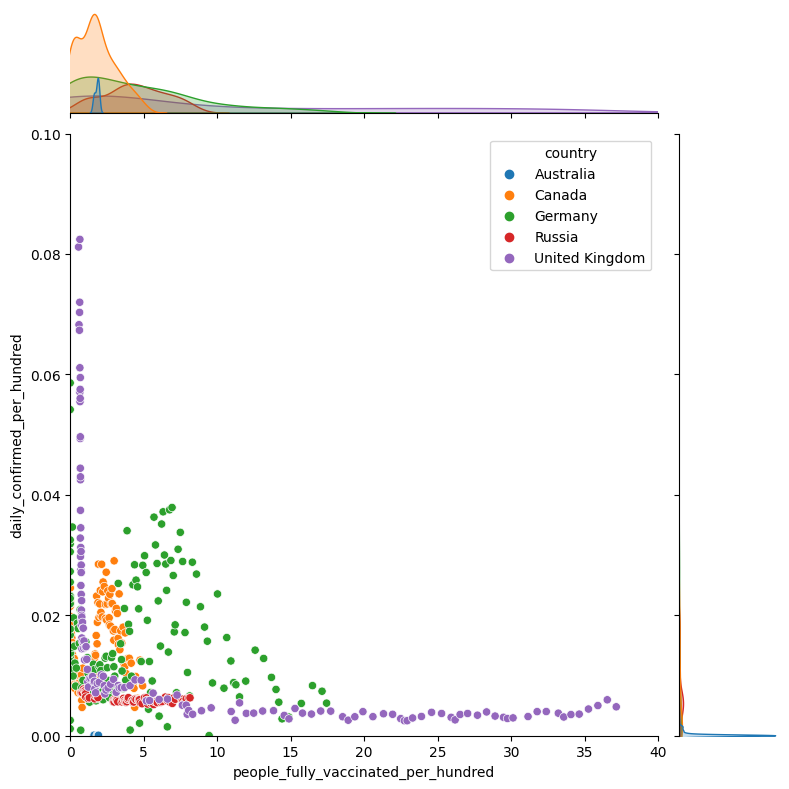

In [ ]:
jointplot = sns.jointplot(data=croped_covid_df, x='people_fully_vaccinated_per_hundred',\
    y='daily_confirmed_per_hundred', hue='country', xlim=(0, 40), ylim=(0, 0.1), height=8)

Text(0.5, 1.0, 'Тепловая карта вакцинации')

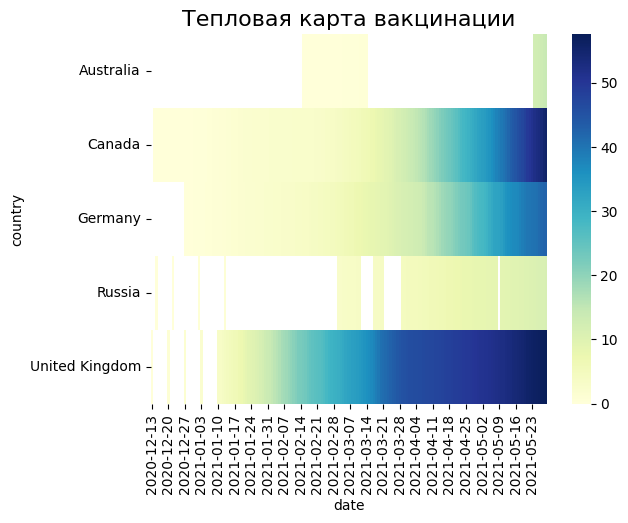

In [ ]:
pivot = croped_covid_df.pivot_table(values='people_vaccinated_per_hundred', columns='date', index='country')
pivot.columns = pivot.columns.astype('string')
heatmap = sns.heatmap(data=pivot, cmap='YlGnBu')
heatmap.set_title('Тепловая карта вакцинации', fontsize=16)

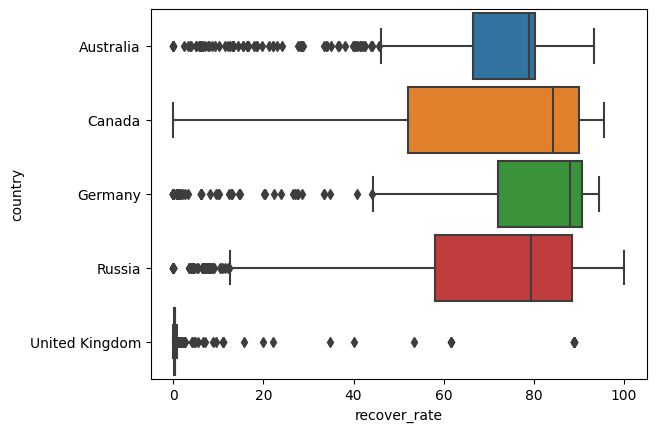

In [ ]:
boxplot = sns.boxplot(data=croped_covid_df, x='recover_rate', y='country', orient='h', width=0.9)

In [ ]:
croped_covid_df['confirmed_per_hundred'] = croped_covid_df['confirmed']/croped_covid_df['population']

In [ ]:
pivot = croped_covid_df.pivot_table(values='confirmed_per_hundred', columns='date', index='country')

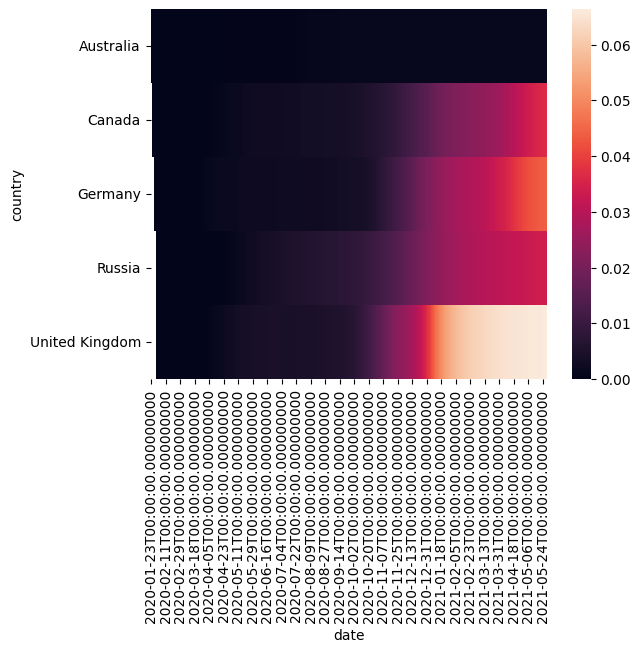

In [ ]:
heatmap = sns.heatmap(data=pivot)

In [ ]:
import plotly
import plotly.express as px
plotly.__version__


'5.10.0'

In [ ]:
line_data = covid_df.groupby('date', as_index=False).sum()
fig = px.line(data_frame=line_data, x='date', y=['confirmed', 'recovered', 'deaths', 'active'],\
    height=500, width=1000, title='Different cases over time')


C:\Users\Anna\AppData\Local\Temp\ipykernel_20492\3381894448.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': 'variable=confirmed<br>date=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': 'confirmed',
              'line': {'color': '#636efa', 'dash': 'solid'},
              'marker': {'symbol': 'circle'},
              'mode': 'lines',
              'name': 'confirmed',
              'showlegend': True,
              'type': 'scattergl',
              'x': array([datetime.datetime(2020, 1, 22, 0, 0),
                          datetime.datetime(2020, 1, 23, 0, 0),
                          datetime.datetime(2020, 1, 24, 0, 0), ...,
                          datetime.datetime(2021, 5, 27, 0, 0),
                          datetime.datetime(2021, 5, 28, 0, 0),
                          datetime.datetime(2021, 5, 29, 0, 0)], dtype=object),
              'xaxis': 'x',
              'y': array([5.57000000e+02, 1.09700000e+03, 9.41000000e+02, ..., 1.68970791e+08,
                          1.69470725e+08, 1.69951560e+08]),
              'yaxis': 'y'},
             {'hovertemplate': 'variable=recovered<br>date=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': 'recovered',
              'line': {'color': '#EF553B', 'dash': 'solid'},
              'marker': {'symbol': 'circle'},
              'mode': 'lines',
              'name': 'recovered',
              'showlegend': True,
              'type': 'scattergl',
              'x': array([datetime.datetime(2020, 1, 22, 0, 0),
                          datetime.datetime(2020, 1, 23, 0, 0),
                          datetime.datetime(2020, 1, 24, 0, 0), ...,
                          datetime.datetime(2021, 5, 27, 0, 0),
                          datetime.datetime(2021, 5, 28, 0, 0),
                          datetime.datetime(2021, 5, 29, 0, 0)], dtype=object),
              'xaxis': 'x',
              'y': array([3.00000000e+01, 6.00000000e+01, 3.90000000e+01, ..., 1.06078106e+08,
                          1.06633069e+08, 1.07140669e+08]),
              'yaxis': 'y'},
             {'hovertemplate': 'variable=deaths<br>date=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': 'deaths',
              'line': {'color': '#00cc96', 'dash': 'solid'},
              'marker': {'symbol': 'circle'},
              'mode': 'lines',
              'name': 'deaths',
              'showlegend': True,
              'type': 'scattergl',
              'x': array([datetime.datetime(2020, 1, 22, 0, 0),
                          datetime.datetime(2020, 1, 23, 0, 0),
                          datetime.datetime(2020, 1, 24, 0, 0), ...,
                          datetime.datetime(2021, 5, 27, 0, 0),
                          datetime.datetime(2021, 5, 28, 0, 0),
                          datetime.datetime(2021, 5, 29, 0, 0)], dtype=object),
              'xaxis': 'x',
              'y': array([1.700000e+01, 3.400000e+01, 2.600000e+01, ..., 3.511297e+06,
                          3.523117e+06, 3.533619e+06]),
              'yaxis': 'y'},
             {'hovertemplate': 'variable=active<br>date=%{x}<br>value=%{y}<extra></extra>',
              'legendgroup': 'active',
              'line': {'color': '#ab63fa', 'dash': 'solid'},
              'marker': {'symbol': 'circle'},
              'mode': 'lines',
              'name': 'active',
              'showlegend': True,
              'type': 'scattergl',
              'x': array([datetime.datetime(2020, 1, 22, 0, 0),
                          datetime.datetime(2020, 1, 23, 0, 0),
                          datetime.datetime(2020, 1, 24, 0, 0), ...,
                          datetime.datetime(2021, 5, 27, 0, 0),
                          datetime.datetime(2021, 5, 28, 0, 0),
                          datetime.datetime(2021, 5, 29, 0, 0)], dtype=object),
              'xaxis': 'x',
              'y': array([5.1000000e+02, 1.0030000e+03, 8.7600000e+02, ..., 5.9381388e+07,
                          5.9314539e+07, 5.9277272e+07]),
              'yaxis': 'y'}],
    'layout': {'height': 500,
            

In [ ]:
bar_data = covid_df.groupby(by=['country'], as_index=False)[['recover_rate']].mean().\
    round(2).nlargest(10, columns='recover_rate')


In [ ]:
fig = px.bar(data_frame=bar_data, x='country', y='recover_rate', color='country', \
    text='recover_rate', orientation='v', height=500, width=1000, \
    title='Top 10 Countries for Recover Rate')


In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'Diamond Princess',
              'marker': {'color': '#636efa', 'pattern': {'shape': ''}},
              'name': 'Diamond Princess',
              'offsetgroup': 'Diamond Princess',
              'orientation': 'v',
              'showlegend': True,
              'text': array([94.04]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['Diamond Princess'], dtype=object),
              'xaxis': 'x',
              'y': array([94.04]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'Micronesia',
              'marker': {'color': '#EF553B', 'pattern': {'shape': ''}},
              'name': 'Micronesia',
              'offsetgroup': 'Micronesia',
              'orientation': 'v',
              'showlegend': True,
              'text': array([93.8]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['Micronesia'], dtype=object),
              'xaxis': 'x',
              'y': array([93.8]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'Brunei',
              'marker': {'color': '#00cc96', 'pattern': {'shape': ''}},
              'name': 'Brunei',
              'offsetgroup': 'Brunei',
              'orientation': 'v',
              'showlegend': True,
              'text': array([89.97]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['Brunei'], dtype=object),
              'xaxis': 'x',
              'y': array([89.97]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'Macau',
              'marker': {'color': '#ab63fa', 'pattern': {'shape': ''}},
              'name': 'Macau',
              'offsetgroup': 'Macau',
              'orientation': 'v',
              'showlegend': True,
              'text': array([87.86]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['Macau'], dtype=object),
              'xaxis': 'x',
              'y': array([87.86]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'China',
              'marker': {'color': '#FFA15A', 'pattern': {'shape': ''}},
              'name': 'China',
              'offsetgroup': 'China',
              'orientation': 'v',
              'showlegend': True,
              'text': array([86.99]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['China'], dtype=object),
              'xaxis': 'x',
              'y': array([86.99]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 'Marshall Islands',
              'marker': {'color': '#19d3f3', 'pattern': {'shape': ''}},
              'name': 'Marshall Islands',
              'offsetgroup': 'Marshall Islands',
              'orientation': 'v',
              'showlegend': True,
              'text': array([86.92]),
              'textposition': 'auto',
              'type': 'bar',
              'x': array(['Marshall Islands'], dtype=object),
              'xaxis': 'x',
              'y': array([86.92]),
              'yaxis': 'y'},
             {'alignmentgroup': 'True',
              'hovertemplate': 'country=%{x}<br>recover_rate=%{text}<extra></extra>',
              'legendgroup': 

In [ ]:
treemap_data = covid_df.groupby(by='country', as_index=False)[['daily_recovered']].mean().round(2)
fig = px.treemap(data_frame=treemap_data, path=['country'], values='daily_recovered', \
    height=500, width=1000, title='Daily Recovered Cases by Country')

In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'branchvalues': 'total',
              'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
              'hovertemplate': ('labels=%{label}<br>daily_recov' ... 'nt}<br>id=%{id}<extra></extra>'),
              'ids': array(['Afghanistan', 'Albania', 'Algeria', ..., 'Zambia', 'Zimbabwe',
                            'occupied Palestinian territory'], dtype=object),
              'labels': array(['Afghanistan', 'Albania', 'Algeria', ..., 'Zambia', 'Zimbabwe',
                               'occupied Palestinian territory'], dtype=object),
              'name': '',
              'parents': array(['', '', '', ..., '', '', ''], dtype=object),
              'type': 'treemap',
              'values': array([124.52, 289.72, 194.81, ..., 209.6 ,  84.09,   0.  ])}],
    'layout': {'height': 500,
               'legend': {'tracegroupgap': 0},
               'template': '...',
               'title': {'text': 'Daily Recovered Cases by Country'},
               'width': 1000}
})

In [ ]:
choropleth_data = covid_df.sort_values(by='date')
choropleth_data['date'] = choropleth_data['date'].astype('string')
fig = px.choropleth(data_frame=choropleth_data, locations='country', locationmode='country names',\
    color='confirmed', range_color=[0, 30e6], animation_frame='date', \
    title='Global Spread of Covid-19', height=500, width=800, color_continuous_scale='Reds')

In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'coloraxis': 'coloraxis',
              'geo': 'geo',
              'hovertemplate': 'date=2020-01-22<br>country=%{location}<br>confirmed=%{z}<extra></extra>',
              'locationmode': 'country names',
              'locations': array(['Japan', 'Hong Kong', 'China', 'Thailand', 'Taiwan', 'Macau',
                                  'Kiribati', 'South Korea', 'United States'], dtype=object),
              'name': '',
              'type': 'choropleth',
              'z': array([  2.,   0., 547.,   4.,   1.,   1.,   0.,   1.,   1.])}],
    'frames': [{'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-22<br>country=%{location}<br>confirmed=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Japan', 'Hong Kong', 'China', 'Thailand', 'Taiwan', 'Macau',
                                              'Kiribati', 'South Korea', 'United States'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([  2.,   0., 547.,   4.,   1.,   1.,   0.,   1.,   1.])}],
                'name': '2020-01-22'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-23<br>country=%{location}<br>confirmed=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Mexico', 'United States', 'Taiwan', 'Vietnam', 'Malaysia', 'Thailand',
                                              'Japan', 'Hong Kong', 'South Korea', 'Philippines', 'Colombia',
                                              'Brazil', 'Macau', 'Singapore', 'Australia', 'Kiribati', 'China'],
                                             dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([0.000e+00, 1.000e+00, 1.000e+00, 2.000e+00, 0.000e+00, 4.000e+00,
                                      1.000e+00, 2.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
                                      2.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 1.082e+03])}],
                'name': '2020-01-23'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-24<br>country=%{location}<br>confirmed=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Hong Kong', 'Singapore', 'Japan', 'United States', 'Kiribati',
                                              'France', 'Vietnam', 'Taiwan', 'Thailand', 'South Korea', 'China',
                                              'Macau'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([  2.,   3.,   2.,   2.,   0.,   2.,   2.,   3.,   5.,   2., 916.,   2.])}],
                'name': '2020-01-24'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-25<br>country=%{location}<br>confirmed=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Singapore', 'South Korea', 'Malaysia', 'France', 'Japan', 'Nepal',
                                              'Macau', 'China', 'Vietnam', 'Australia', 'Thailand', 'Hong Kong',
                                              'Taiwan', 'United States', 'Kiribati'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([3.000e+00, 2.000e+00, 3.000e+00, 3.000e+00, 2.000e+00, 1.000e+00,
                                      2.0

In [ ]:
countries = ['United States', 'United Kingdom', 'Brazil', 'Russia', 'France']
scatter_data = covid_df[covid_df['country'].isin(countries)]

fig = px.scatter_3d(data_frame=scatter_data, x='daily_confirmed', y='daily_deaths', \
    z='daily_vaccinations', color='country', log_x=True, log_y=True, height=800, width=1000)

In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': ('country=Brazil<br>daily_confir' ... 'ccinations=%{z}<extra></extra>'),
              'legendgroup': 'Brazil',
              'marker': {'color': '#636efa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Brazil',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([       nan, 1.0000e+00, 0.0000e+00, ..., 6.7467e+04, 4.9768e+04,
                          7.9670e+04]),
              'y': array([  nan,    0.,    0., ..., 2245., 2371., 2012.]),
              'z': array([     nan,      nan,      nan, ..., 1329775., 1273730., 1123150.])},
             {'hovertemplate': ('country=France<br>daily_confir' ... 'ccinations=%{z}<extra></extra>'),
              'legendgroup': 'France',
              'marker': {'color': '#EF553B', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'France',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([       nan, 1.0000e+00, 0.0000e+00, ..., 1.3933e+04, 1.1274e+04,
                          1.1527e+04]),
              'y': array([ nan,   0.,   0., ..., 142., 125.,  66.]),
              'z': array([    nan,     nan,     nan, ..., 486618., 490268., 493384.])},
             {'hovertemplate': ('country=Russia<br>daily_confir' ... 'ccinations=%{z}<extra></extra>'),
              'legendgroup': 'Russia',
              'marker': {'color': '#00cc96', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'Russia',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([  nan,    0.,    0., ..., 8911., 9126., 9155.]),
              'y': array([ nan,   0.,   0., ..., 395., 396., 395.]),
              'z': array([    nan,     nan,     nan, ..., 367571., 377834., 277909.])},
             {'hovertemplate': ('country=United Kingdom<br>dail' ... 'ccinations=%{z}<extra></extra>'),
              'legendgroup': 'United Kingdom',
              'marker': {'color': '#ab63fa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'United Kingdom',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([  nan,    0.,    0., ..., 3384., 4030., 3241.]),
              'y': array([nan,  0.,  0., ..., 10., 10.,  7.]),
              'z': array([    nan,     nan,     nan, ..., 595836., 594987., 572132.])},
             {'hovertemplate': ('country=United States<br>daily' ... 'ccinations=%{z}<extra></extra>'),
              'legendgroup': 'United States',
              'marker': {'color': '#FFA15A', 'symbol': 'circle'},
              'mode': 'markers',
              'name': 'United States',
              'scene': 'scene',
              'showlegend': True,
              'type': 'scatter3d',
              'x': array([       nan, 0.0000e+00, 1.0000e+00, ..., 2.7525e+04, 2.1968e+04,
                          1.1976e+04]),
              'y': array([  nan,    0.,    0., ..., 1338.,  675.,  343.]),
              'z': array([     nan,      nan,      nan, ..., 1618194., 1500632., 1394832.])}],
    'layout': {'height': 800,
               'legend': {'title': {'text': 'country'}, 'tracegroupgap': 0},
               'margin': {'t': 60},
               'scene': {'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
                         'xaxis': {'title': {'text': 'daily_confirmed'}, 'type': 'log'},
                         'yaxis': {'title': {'text': 'daily_deaths'}, 'type': 'log'},
                         'zaxis': {'title': {'text': 'daily_vaccinations'}}},
               'template': '...',
               'width': 1000}
})

In [ ]:
fig.write_html('plotly/scatter_3d.html')

In [ ]:
line_data = covid_df.groupby('date', as_index=False).sum()

C:\Users\Anna\AppData\Local\Temp\ipykernel_19964\906408220.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
fig = px.line(data_frame=line_data, x='date', y='daily_vaccinations', height=500, width=1000)

In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': 'date=%{x}<br>daily_vaccinations=%{y}<extra></extra>',
              'legendgroup': '',
              'line': {'color': '#636efa', 'dash': 'solid'},
              'marker': {'symbol': 'circle'},
              'mode': 'lines',
              'name': '',
              'orientation': 'v',
              'showlegend': False,
              'type': 'scatter',
              'x': array([datetime.datetime(2020, 1, 22, 0, 0),
                          datetime.datetime(2020, 1, 23, 0, 0),
                          datetime.datetime(2020, 1, 24, 0, 0), ...,
                          datetime.datetime(2021, 5, 27, 0, 0),
                          datetime.datetime(2021, 5, 28, 0, 0),
                          datetime.datetime(2021, 5, 29, 0, 0)], dtype=object),
              'xaxis': 'x',
              'y': array([       0.,        0.,        0., ..., 31397473., 31584424., 32236698.]),
              'yaxis': 'y'}],
    'layout': {'height': 500,
               'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'template': '...',
               'width': 1000,
               'xaxis': {'anchor': 'y', 'domain': [0.0, 1.0], 'title': {'text': 'date'}},
               'yaxis': {'anchor': 'x', 'domain': [0.0, 1.0], 'title': {'text': 'daily_vaccinations'}}}
})

In [ ]:
choropleth_data = covid_df.sort_values(by='date')
choropleth_data['date'] = choropleth_data['date'].astype('string')

fig = px.choropleth(data_frame=choropleth_data, locations='country', locationmode='country names',\
    color='total_vaccinations', animation_frame='date', range_color=[0, 30e6], width=800, \
    height=500, color_continuous_scale='viridis')

In [ ]:
choropleth_data.head()

,date,country,confirmed,deaths,recovered,active,daily_confirmed,daily_deaths,daily_recovered,total_vaccinations,people_vaccinated,people_vaccinated_per_hundred,people_fully_vaccinated,people_fully_vaccinated_per_hundred,daily_vaccinations,vaccines,death_rate,recover_rate
39389,2020-01-22,Japan,2.0,0.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.00000
33822,2020-01-22,Hong Kong,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16251,2020-01-22,China,547.0,17.0,28.0,502.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.107861,5.11883
77965,2020-01-22,Thailand,4.0,0.0,2.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,50.00000
76636,2020-01-22,Taiwan,1.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.00000


In [ ]:
fig

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'coloraxis': 'coloraxis',
              'geo': 'geo',
              'hovertemplate': 'date=2020-01-22<br>country=%{location}<br>total_vaccinations=%{z}<extra></extra>',
              'locationmode': 'country names',
              'locations': array(['Japan', 'Hong Kong', 'China', 'Thailand', 'Taiwan', 'Macau',
                                  'Kiribati', 'South Korea', 'United States'], dtype=object),
              'name': '',
              'type': 'choropleth',
              'z': array([nan, nan, nan, nan, nan, nan, nan, nan, nan])}],
    'frames': [{'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-22<br>country=%{location}<br>total_vaccinations=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Japan', 'Hong Kong', 'China', 'Thailand', 'Taiwan', 'Macau',
                                              'Kiribati', 'South Korea', 'United States'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([nan, nan, nan, nan, nan, nan, nan, nan, nan])}],
                'name': '2020-01-22'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-23<br>country=%{location}<br>total_vaccinations=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Mexico', 'United States', 'Taiwan', 'Vietnam', 'Malaysia', 'Thailand',
                                              'Japan', 'Hong Kong', 'South Korea', 'Philippines', 'Colombia',
                                              'Brazil', 'Macau', 'Singapore', 'Australia', 'Kiribati', 'China'],
                                             dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
                                      nan, nan, nan])}],
                'name': '2020-01-23'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-24<br>country=%{location}<br>total_vaccinations=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Hong Kong', 'Singapore', 'Japan', 'United States', 'Kiribati',
                                              'France', 'Vietnam', 'Taiwan', 'Thailand', 'South Korea', 'China',
                                              'Macau'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan])}],
                'name': '2020-01-24'},
               {'data': [{'coloraxis': 'coloraxis',
                          'geo': 'geo',
                          'hovertemplate': 'date=2020-01-25<br>country=%{location}<br>total_vaccinations=%{z}<extra></extra>',
                          'locationmode': 'country names',
                          'locations': array(['Singapore', 'South Korea', 'Malaysia', 'France', 'Japan', 'Nepal',
                                              'Macau', 'China', 'Vietnam', 'Australia', 'Thailand', 'Hong Kong',
                                              'Taiwan', 'United States', 'Kiribati'], dtype=object),
                          'name': '',
                          'type': 'choropleth',
                          'z': array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
                                      nan])}],
                'name': '2020-01-25'},
               {'data': [{'coloraxis': 'coloraxis',
                        